<a href="https://colab.research.google.com/github/Marco-Escamilla/deep-learning/blob/main/SAGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import tensorflow as tf
from tensorflow.keras import Model
from tensorflow.keras import layers
from tensorflow.keras.layers import Layer, Dense, Input, LeakyReLU, Reshape, Conv2D, Dense, Embedding
from tensorflow.keras.layers import UpSampling2D, AveragePooling2D, GlobalAveragePooling2D, Flatten
from tensorflow.keras.activations import relu, tanh
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from tensorflow.keras.optimizers import RMSprop, Adam
import tensorflow_datasets as tfds

import numpy as np
import matplotlib.pyplot as plt
import os

In [ ]:
#from google.colab import drive
#drive.mount('/content/drive', force_remount=True)

('/content/drive/My Drive/Modelos/SAGAN.h5')

In [ ]:
ds_train,  ds_info = tfds.load('cifar10', split='train', as_supervised=True, shuffle_files=True, with_info=True)

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/2 [00:00<?, ? splits/s]

Generating train examples...: 0 examples [00:00, ? examples/s]

Shuffling /root/tensorflow_datasets/cifar10/3.0.2.incompleteDVCEXX/cifar10-train.tfrecord*...:   0%|          …

Generating test examples...: 0 examples [00:00, ? examples/s]

Shuffling /root/tensorflow_datasets/cifar10/3.0.2.incompleteDVCEXX/cifar10-test.tfrecord*...:   0%|          |…

Dataset cifar10 downloaded and prepared to /root/tensorflow_datasets/cifar10/3.0.2. Subsequent calls will reuse this data.


In [ ]:
IMAGE_HEIGHT = IMAGE_WIDTH = 32
IMAGE_SHAPE = (IMAGE_WIDTH, IMAGE_HEIGHT, 3)
BATCH_SIZE = 32
BUFFER_SIZE = 200

def preprocess(image, label):

    image = tf.cast(image, tf.float32)
    image = (image-127.5)/127.5

    label = tf.cast(label, tf.int32)
    return image, label

train_dataset = ds_train.map(preprocess,
                             num_parallel_calls=tf.data.experimental.AUTOTUNE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE).repeat()

In [ ]:
class SpectralNorm(tf.keras.constraints.Constraint):
    def __init__(self, n_iter=5):
        self.n_iter = n_iter

    def call(self, input_weights):
        w = tf.reshape(input_weights, (-1, input_weights.shape[-1]))
        u = tf.random.normal((w.shape[0], 1))
        for _ in range(self.n_iter):
            v = tf.matmul(w, u, transpose_a=True)
            v /= tf.norm(v)

            u = tf.matmul(w, v)
            u /= tf.norm(u)

        spec_norm = tf.matmul(u, tf.matmul(w, v), transpose_a=True)
        return input_weights/spec_norm

In [ ]:
class SelfAttention(Layer):
    def __init__(self):
        super(SelfAttention, self).__init__()

    def build(self, input_shape):
        n, h, w, c = input_shape
        self.n_feats = h * w
        self.conv_theta = Conv2D(c//8, 1, padding='same',
                                 kernel_constraint=SpectralNorm(), name='Conv_Theta')
        self.conv_phi = Conv2D(c//8, 1, padding='same',
                               kernel_constraint=SpectralNorm(), name='Conv_Phi')
        self.conv_g = Conv2D(c//2, 1, padding='same',
                             kernel_constraint=SpectralNorm(), name='Conv_G')
        self.conv_attn_g = Conv2D(c, 1, padding='same',
                                  kernel_constraint=SpectralNorm(), name='Conv_AttnG')
        self.sigma = self.add_weight(shape=[1],
                                initializer='zeros',
                                trainable=True, name='sigma')


    def call(self, x):
        n, h, w, c = x.shape
        theta = self.conv_theta(x)
        theta = tf.reshape(theta, (-1, self.n_feats, theta.shape[-1]))

        phi = self.conv_phi(x)
        phi = tf.nn.max_pool2d(phi, ksize=2, strides=2, padding='VALID')
        phi = tf.reshape(phi, (-1, self.n_feats//4, phi.shape[-1]))

        attn = tf.matmul(theta, phi, transpose_b=True)
        attn = tf.nn.softmax(attn)

        g = self.conv_g(x)
        g = tf.nn.max_pool2d(g, ksize=2, strides=2, padding='VALID')
        g = tf.reshape(g, (-1, self.n_feats//4, g.shape[-1]))

        attn_g = tf.matmul(attn, g)
        attn_g = tf.reshape(attn_g, (-1, h, w, attn_g.shape[-1]))
        attn_g = self.conv_attn_g(attn_g)

        output = x + self.sigma * attn_g

        return output

NameError: ignored

In [ ]:
class ConditionBatchNorm(Layer):
    def __init__(self, n_class=2, decay_rate=0.999, eps=1e-7):
        super(ConditionBatchNorm, self).__init__()
        self.n_class = n_class
        self.decay = decay_rate
        self.eps = 1e-5

    def build(self, input_shape):
        self.input_size = input_shape
        n, h, w, c = input_shape

        self.gamma = self.add_weight(shape=[self.n_class, c],
                                    initializer='ones',
                                    trainable=True, name='gamma')

        self.beta = self.add_weight(shape=[self.n_class, c],
                                    initializer='zeros',
                                    trainable=True, name='beta')

        self.moving_mean = self.add_weight(shape=[1, 1, 1, c], initializer='zeros',
                                          trainable=False, name='moving_mean')

        self.moving_var = self.add_weight(shape=[1, 1, 1, c], initializer='ones',
                                          trainable=False, name='moving_var')

    def call(self, x, labels, training=False):

        beta = tf.gather(self.beta, labels)
        beta = tf.expand_dims(beta, 1)
        gamma = tf.gather(self.gamma, labels)
        gamma = tf.expand_dims(gamma, 1)

        if training:
            mean, var = tf.nn.moments(x, axes=(0,1,2), keepdims=True)
            self.moving_mean.assign(self.decay * self.moving_mean + (1-self.decay)*mean)
            self.moving_var.assign(self.decay * self.moving_var + (1-self.decay)*var)
            output = tf.nn.batch_normalization(x, mean, var, beta, gamma, self.eps)

        else:
            output = tf.nn.batch_normalization(x,
                                               self.moving_mean, self.moving_var,
                                               beta, gamma, self.eps)

        return output

In [ ]:
class Resblock(Layer):
    def __init__(self, filters, n_class):
        super(Resblock, self).__init__(name=f'g_resblock_{filters}x{filters}')
        self.filters = filters
        self.n_class = n_class

    def build(self, input_shape):
        input_filter = input_shape[-1]
        self.conv_1 = Conv2D(self.filters, 3, padding='same', name='conv2d_1',
                            kernel_constraint=SpectralNorm())
        self.conv_2 = Conv2D(self.filters, 3, padding='same', name='conv2d_2',
                             kernel_constraint=SpectralNorm())
        self.cbn_1 = ConditionBatchNorm(self.n_class)
        self.cbn_2 = ConditionBatchNorm(self.n_class)
        self.learned_skip = False

        if self.filters != input_filter:
            self.learned_skip = True
            self.conv_3 = Conv2D(self.filters, 1, padding='same', name='conv2d_3',
                                kernel_constraint=SpectralNorm())
            self.cbn_3 = ConditionBatchNorm(self.n_class)

    def call(self, input_tensor, labels):
        x = self.conv_1(input_tensor)
        x = self.cbn_1(x, labels)
        x = tf.nn.leaky_relu(x, 0.2)

        x = self.conv_2(x)
        x = self.cbn_2(x, labels)
        x = tf.nn.leaky_relu(x, 0.2)

        if self.learned_skip:
            skip = self.conv_3(input_tensor)
            skip = self.cbn_3(skip, labels)
            skip = tf.nn.leaky_relu(skip, 0.2)
        else:
            skip = input_tensor

        output = skip + x
        return output

def build_generator(z_dim, n_class):

    DIM = 64

    z = layers.Input(shape=(z_dim))
    labels = layers.Input(shape=(1), dtype='int32')

    x = Dense(4*4*4*DIM, kernel_constraint=SpectralNorm())(z)
    x = layers.Reshape((4, 4, 4*DIM))(x)

    x = layers.UpSampling2D((2,2))(x)
    x = Resblock(4*DIM, n_class)(x, labels)

    x = layers.UpSampling2D((2,2))(x)
    x = Resblock(2*DIM, n_class)(x, labels)

    x = SelfAttention()(x)

    x = layers.UpSampling2D((2,2))(x)
    x = Resblock(DIM, n_class)(x, labels)

    output_image = tanh(Conv2D(3, 3, padding='same', kernel_constraint=SpectralNorm())(x))

    return Model([z, labels],
                 output_image,
                 name='generator')

In [ ]:
class ResblockDown(Layer):
    def __init__(self, filters, downsample=True):
        super(ResblockDown, self).__init__()
        self.filters = filters
        self.downsample = downsample

    def build(self, input_shape):
        input_filter = input_shape[-1]
        self.conv_1 = Conv2D(self.filters, 3, padding='same', kernel_constraint=SpectralNorm())
        self.conv_2 = Conv2D(self.filters, 3, padding='same', kernel_constraint=SpectralNorm())
        self.learned_skip = False

        if self.filters != input_filter:
            self.learned_skip = True
            self.conv_3 = Conv2D(self.filters, 1, padding='same', kernel_constraint=SpectralNorm())

    def down(self, x):
        return tf.nn.avg_pool(x, [1, 2, 2, 1], [1, 2, 2, 1], 'VALID')

    def call(self, input_tensor):
        x = self.conv_1(input_tensor)
        x = tf.nn.leaky_relu(x, 0.2)

        x = self.conv_2(x)
        x = tf.nn.leaky_relu(x, 0.2)

        if self.downsample:
            x = self.down(x)

        if self.learned_skip:
            skip = self.conv_3(input_tensor)
            skip = tf.nn.leaky_relu(skip, 0.2)
            if self.downsample:
                skip = self.down(skip)
        else:
            skip = input_tensor
        output = skip + x
        return output


In [ ]:
def build_discriminator(n_class):
    DIM = 64
    input_image = Input(shape=IMAGE_SHAPE)
    input_labels = Input(shape=(1))

    embedding = Embedding(n_class, 4*DIM)(input_labels)

    embedding = Flatten()(embedding)

    x = ResblockDown(DIM)(input_image) # 64

    x = ResblockDown(2*DIM)(x) # 32

    x = SelfAttention()(x)

    x = ResblockDown(4*DIM)(x) # 16

    x = ResblockDown(4*DIM, False)(x) # 4

    x = tf.reduce_sum(x, (1, 2))

    embedded_x  = tf.reduce_sum(x * embedding, axis=1,  keepdims=True)

    output = Dense(1)(x)

    output += embedded_x

    return Model([input_image, input_labels], output, name='discriminator')

Step 0 g_loss -1.9969 d_loss 1.5422
4/4 [==============================] - 1s 76ms/step


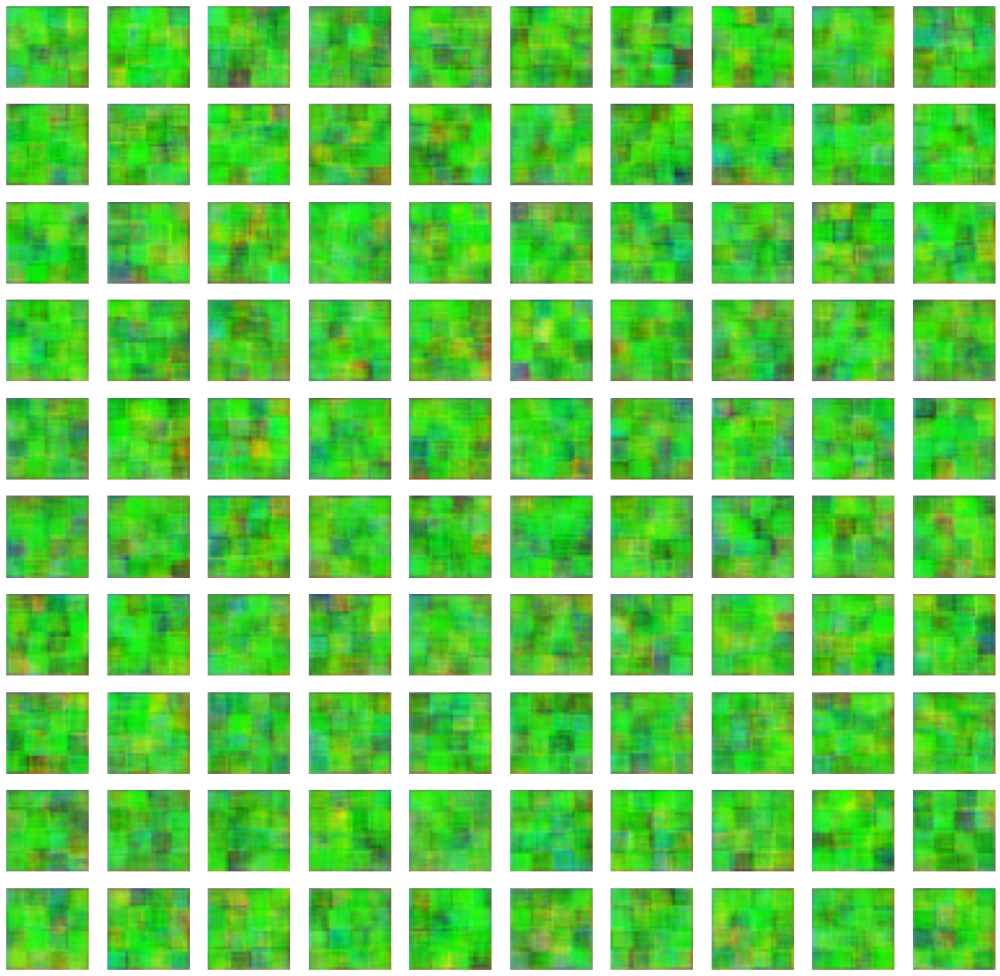

Step 2500 g_loss 1.4902 d_loss 0.2890
4/4 [==============================] - 0s 9ms/step


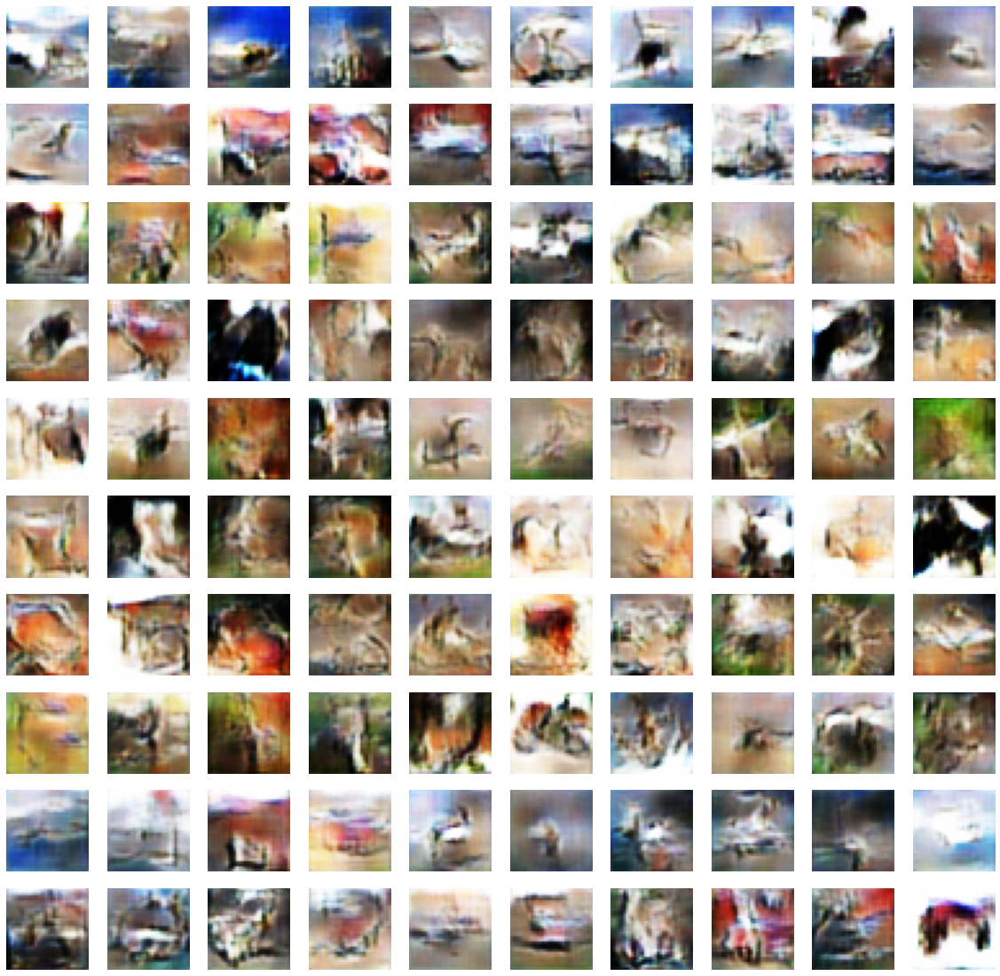

Step 5000 g_loss 1.3801 d_loss 0.2609
4/4 [==============================] - 0s 9ms/step


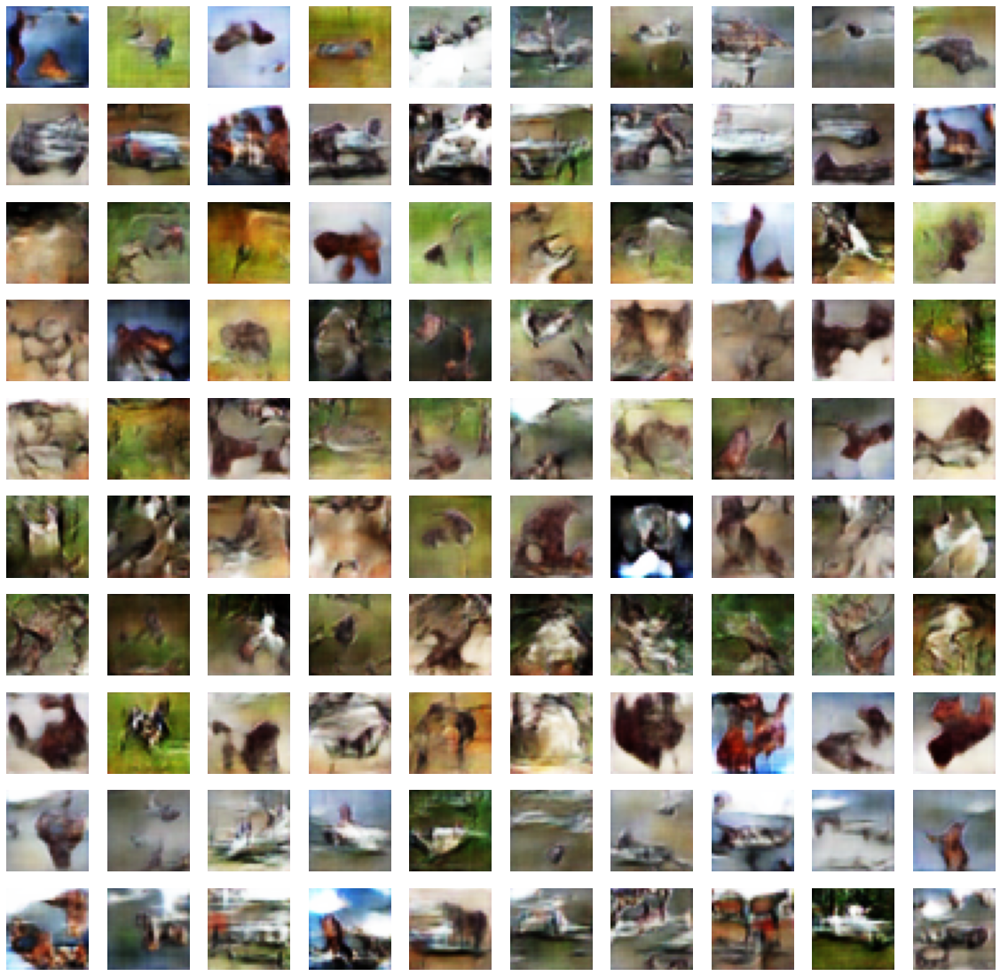

Step 7500 g_loss 1.8460 d_loss 0.3484
4/4 [==============================] - 0s 12ms/step


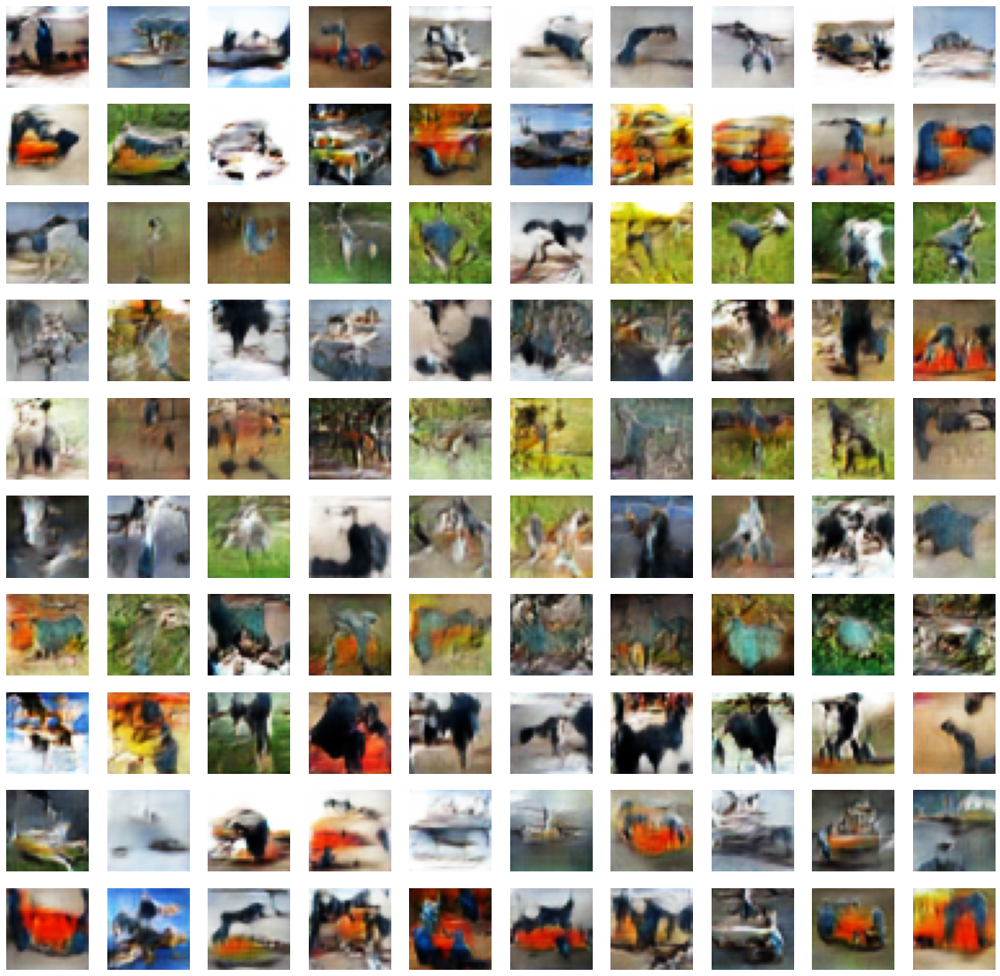

Step 10000 g_loss 1.9335 d_loss 0.3091
4/4 [==============================] - 0s 9ms/step


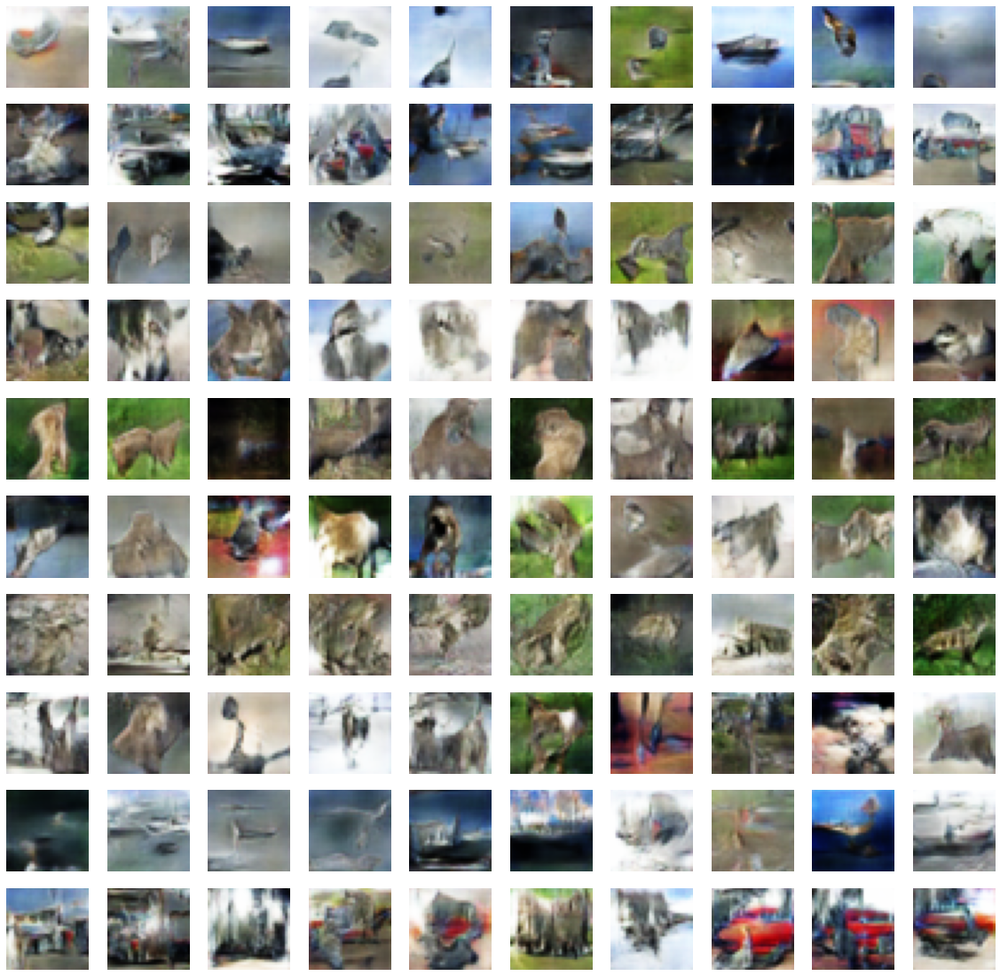

Step 12500 g_loss 3.2506 d_loss 0.1915
4/4 [==============================] - 0s 9ms/step


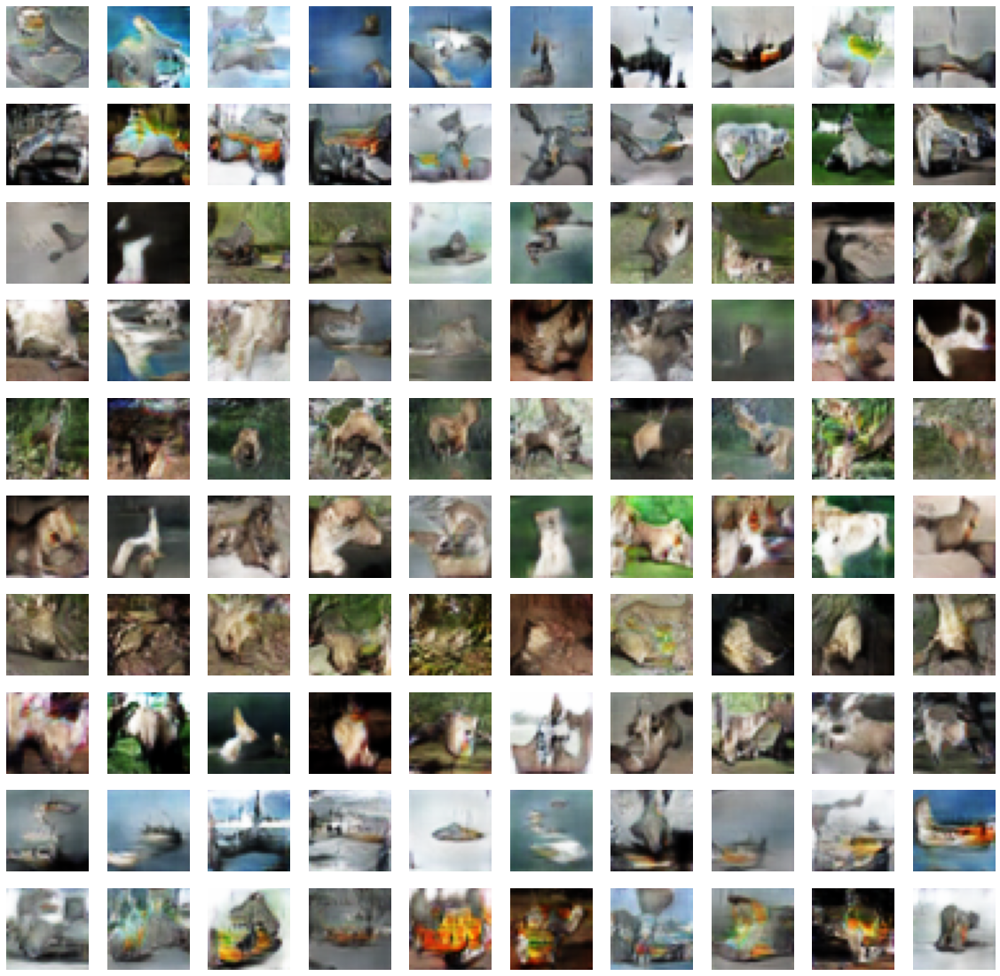

Step 15000 g_loss 3.3614 d_loss 0.2571
4/4 [==============================] - 0s 11ms/step


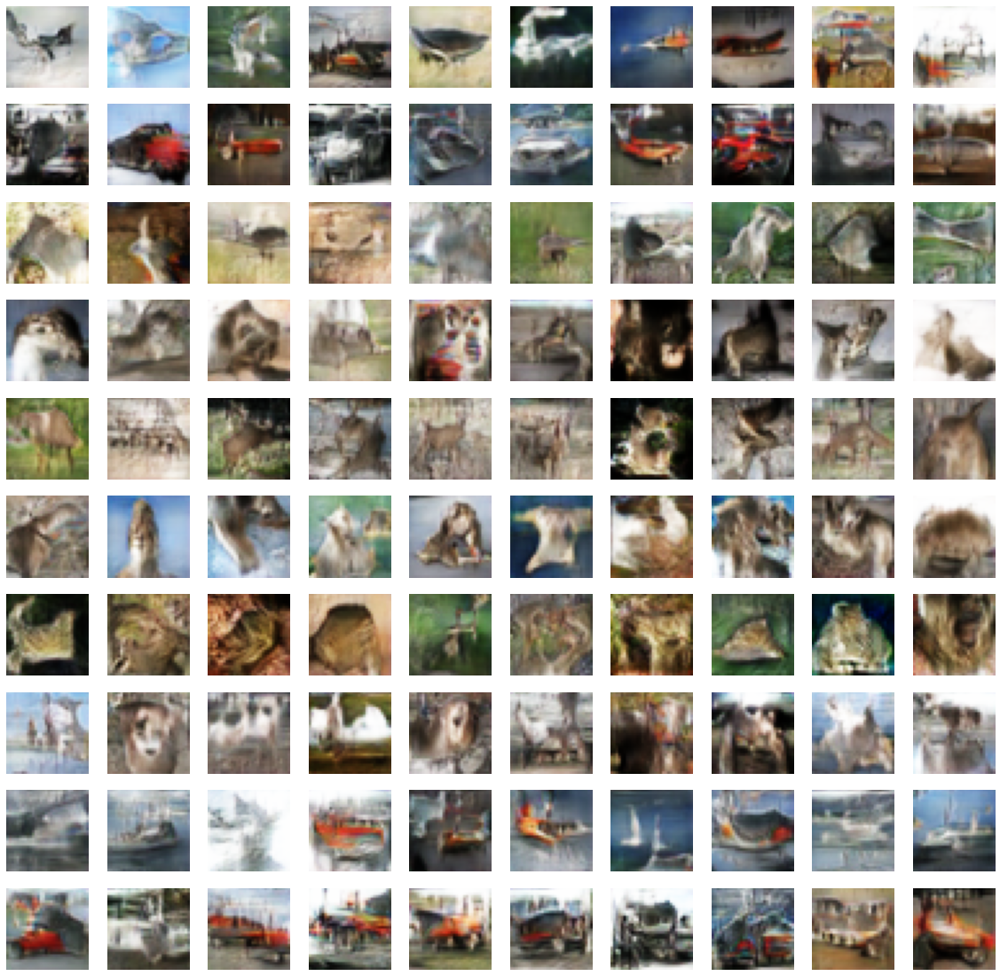

Step 17500 g_loss 1.2664 d_loss 0.4136
4/4 [==============================] - 0s 9ms/step


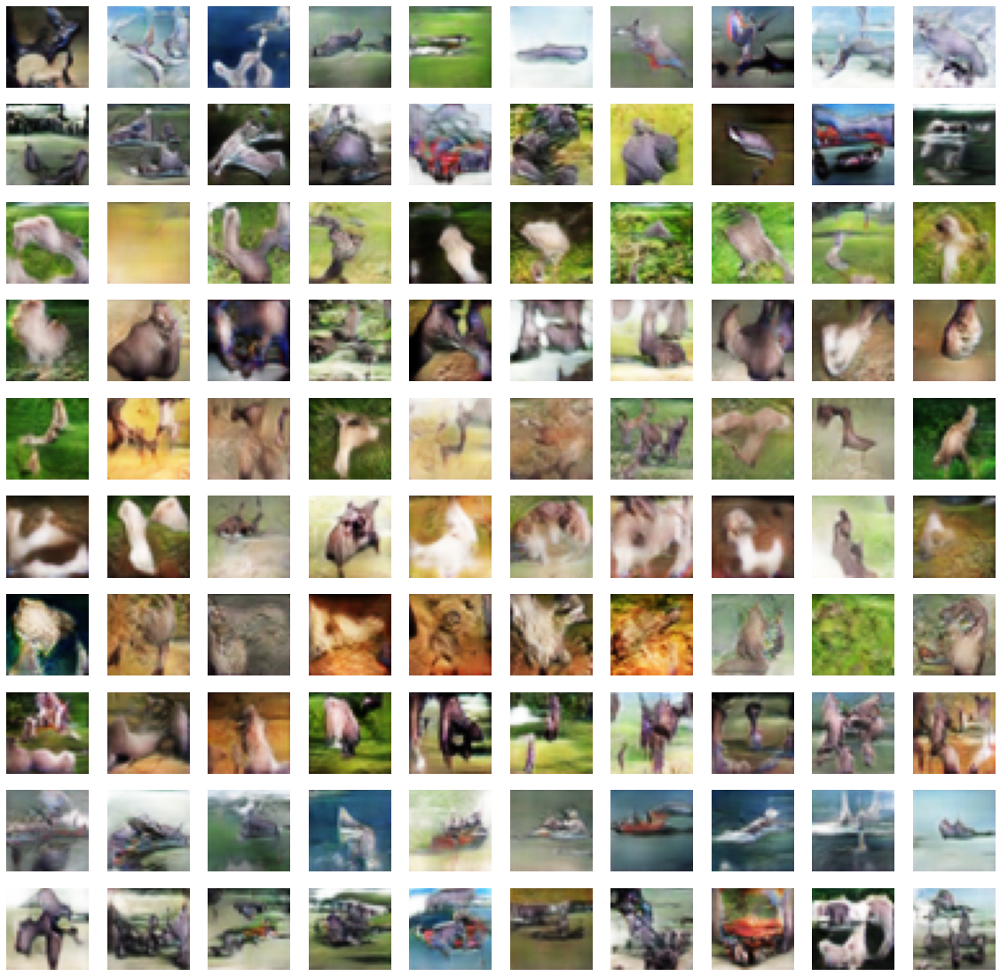

Step 20000 g_loss 2.7603 d_loss 0.2626
4/4 [==============================] - 0s 10ms/step


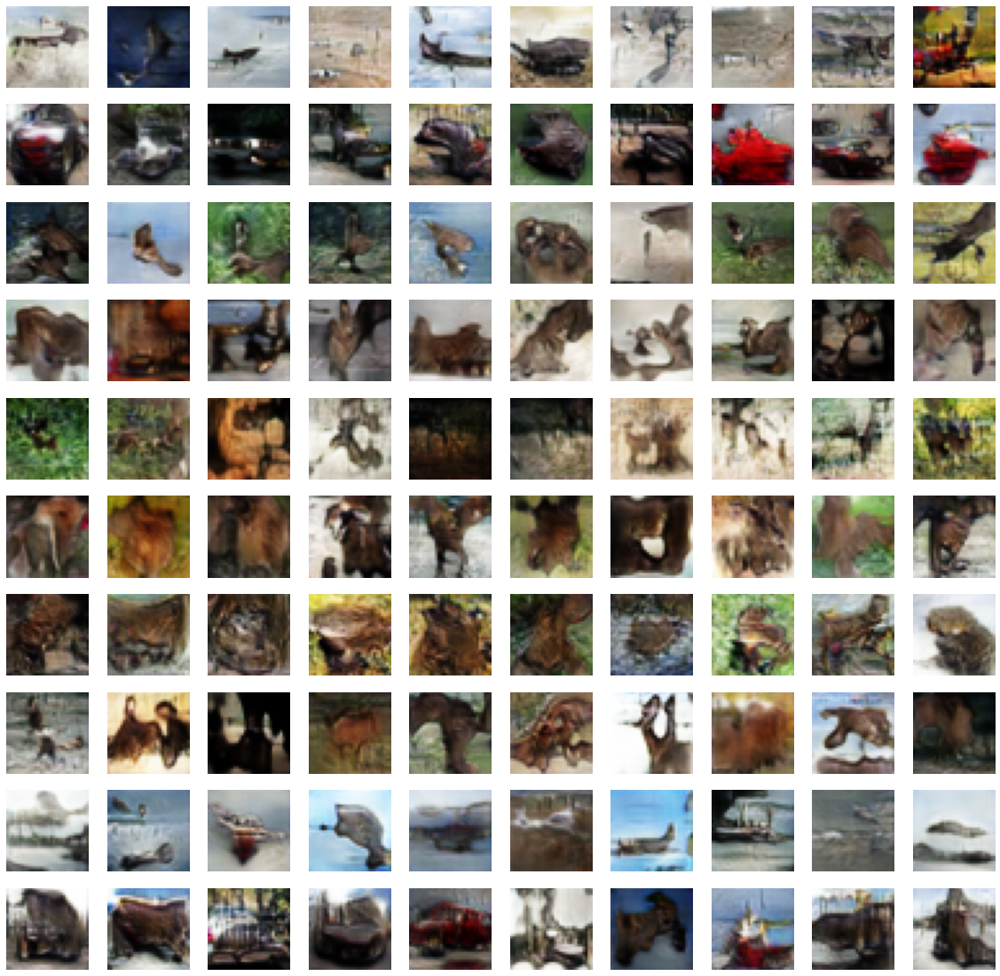

Step 22500 g_loss 1.8584 d_loss 0.2624
4/4 [==============================] - 0s 11ms/step


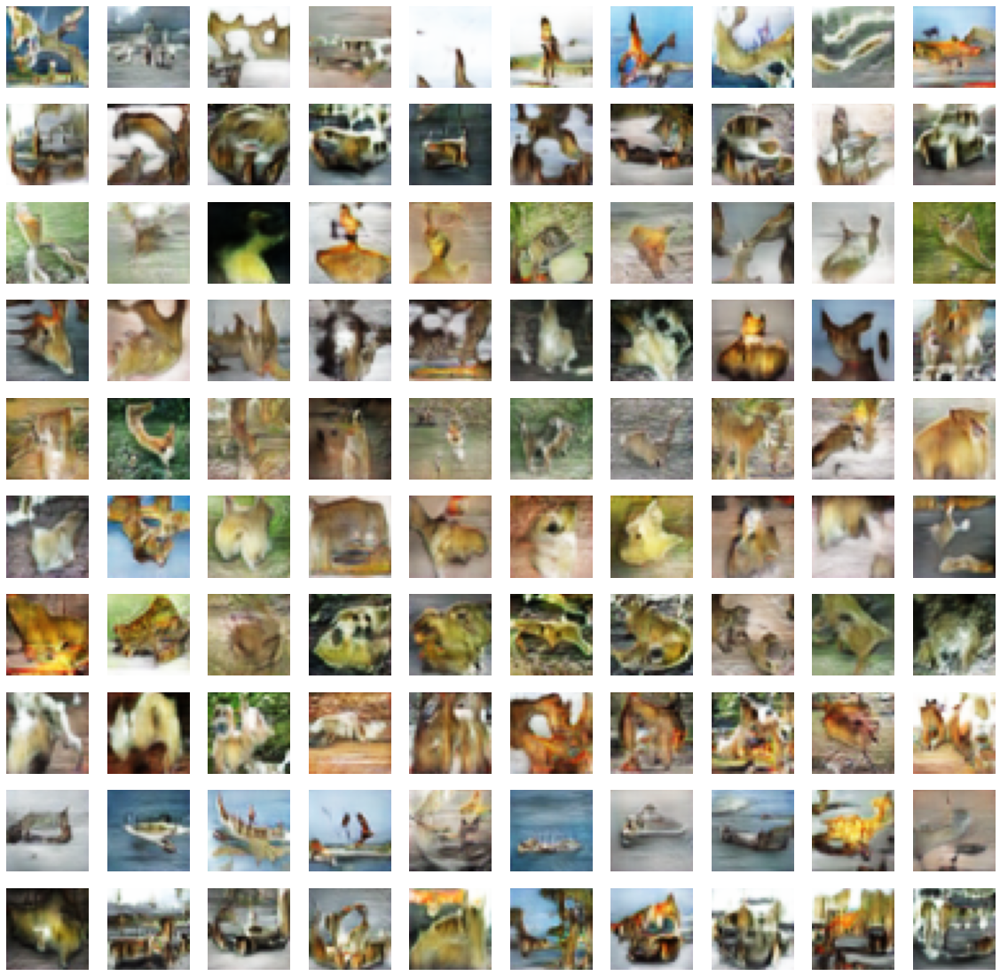

Step 25000 g_loss 1.8784 d_loss 0.3101
4/4 [==============================] - 0s 10ms/step


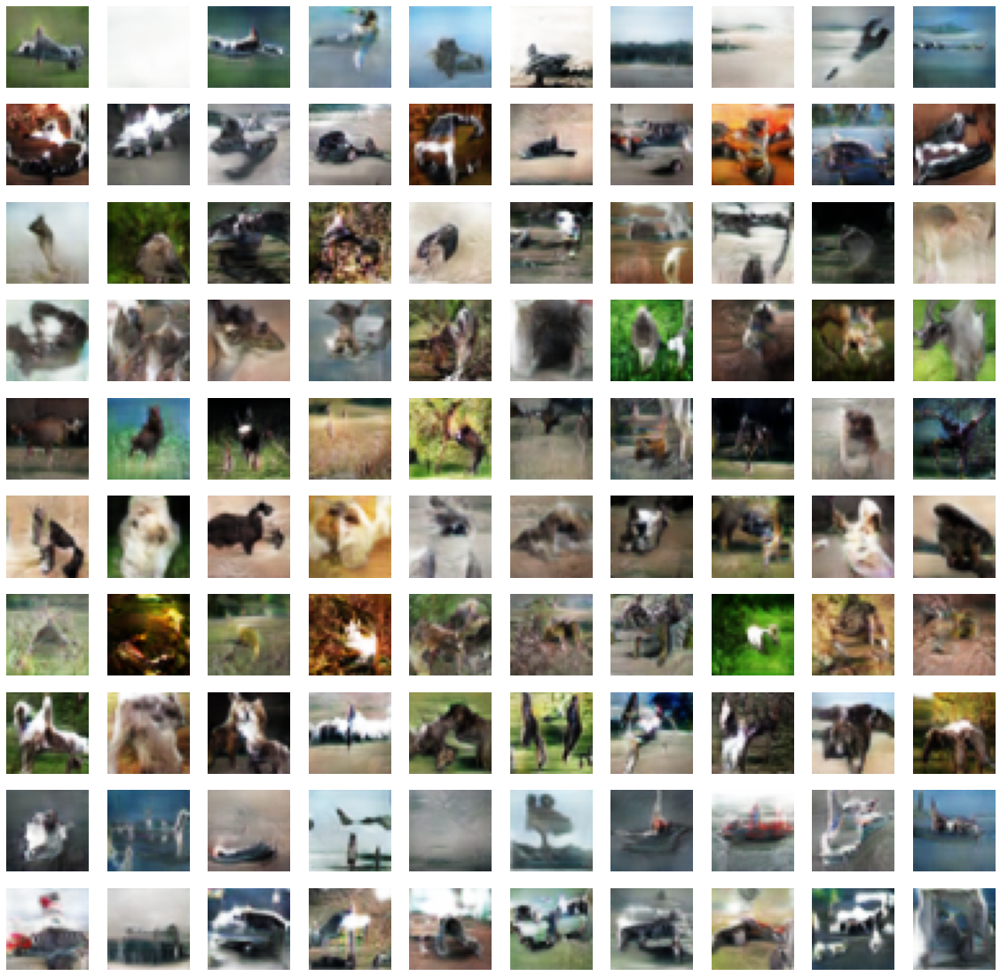

Step 27500 g_loss 2.7873 d_loss 0.3098
4/4 [==============================] - 0s 9ms/step


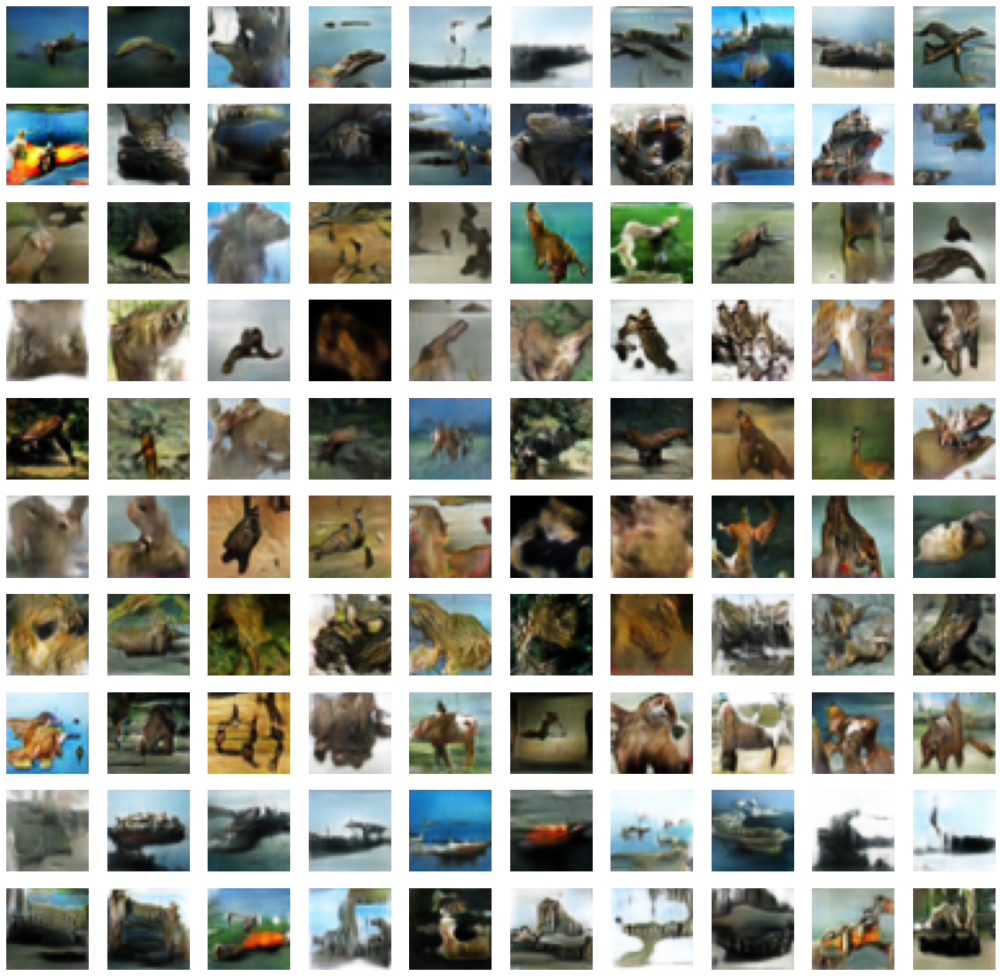

Step 30000 g_loss 2.4539 d_loss 0.0838
4/4 [==============================] - 0s 11ms/step


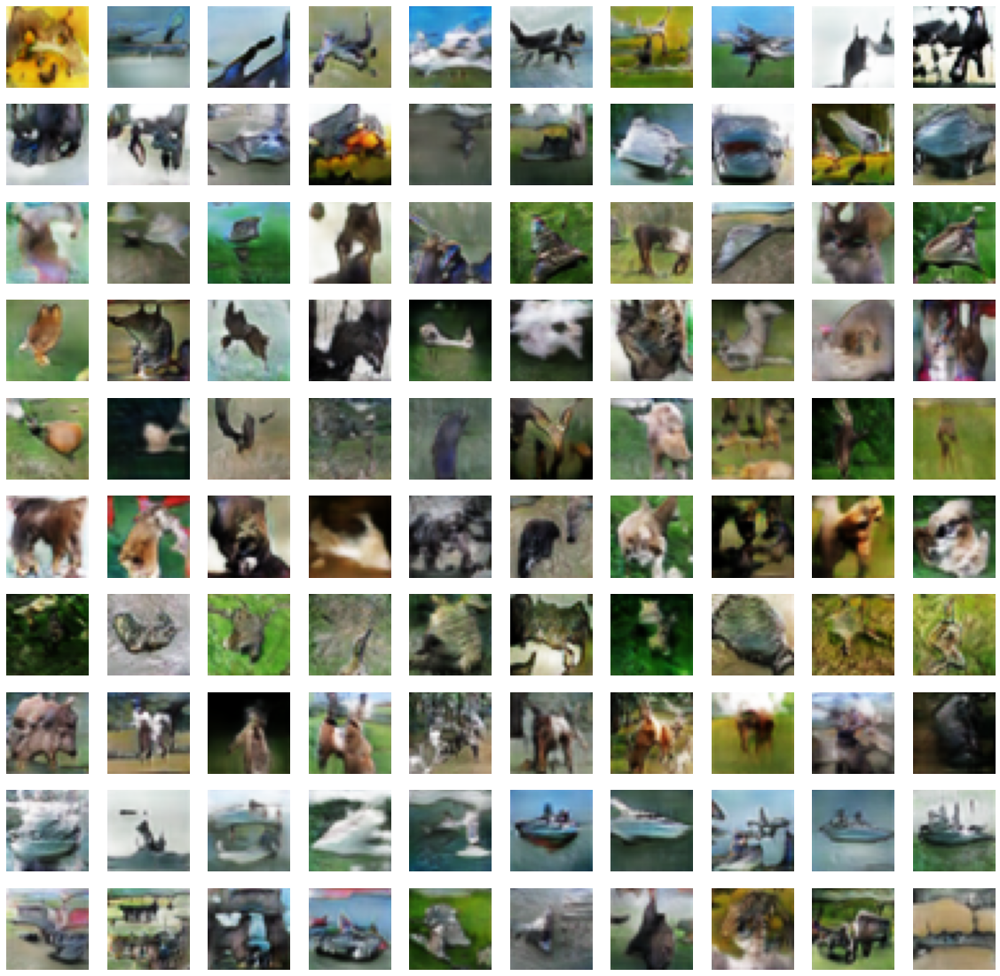

Step 32500 g_loss 2.6988 d_loss 0.1709
4/4 [==============================] - 0s 10ms/step


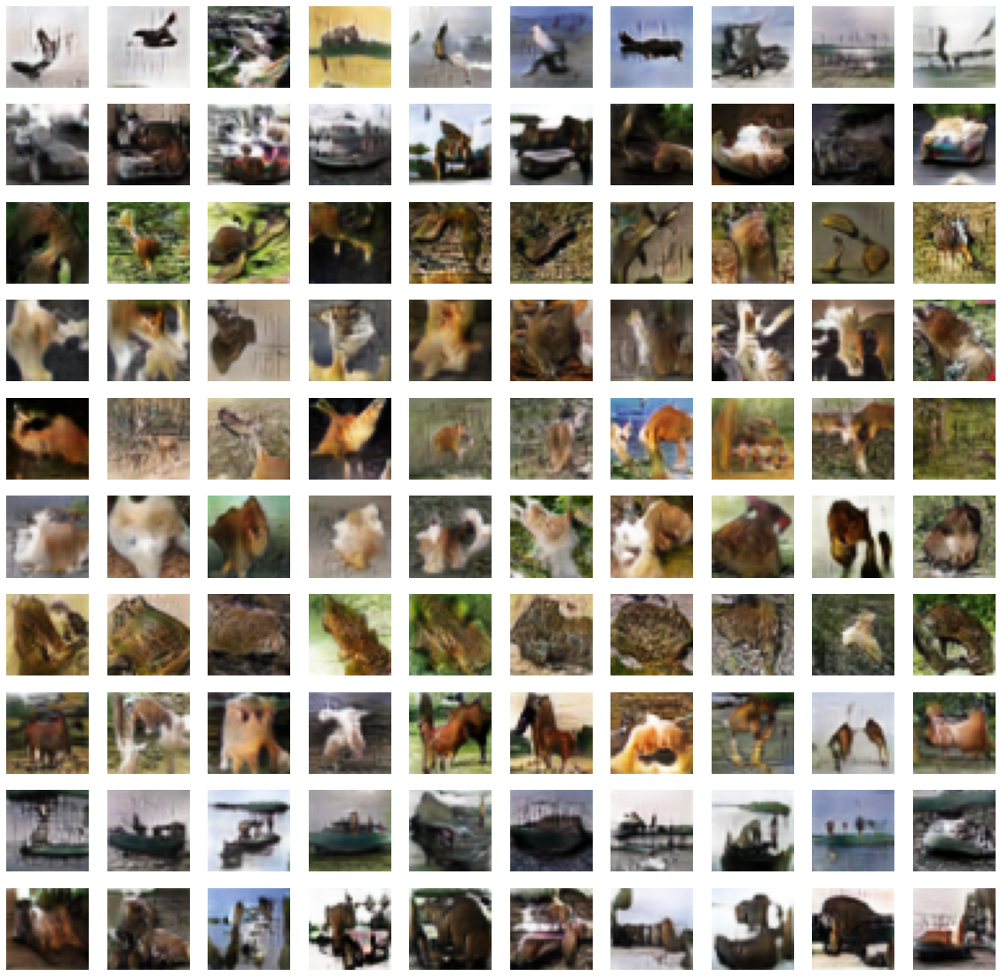

Step 35000 g_loss 3.1908 d_loss 0.1344
4/4 [==============================] - 0s 9ms/step


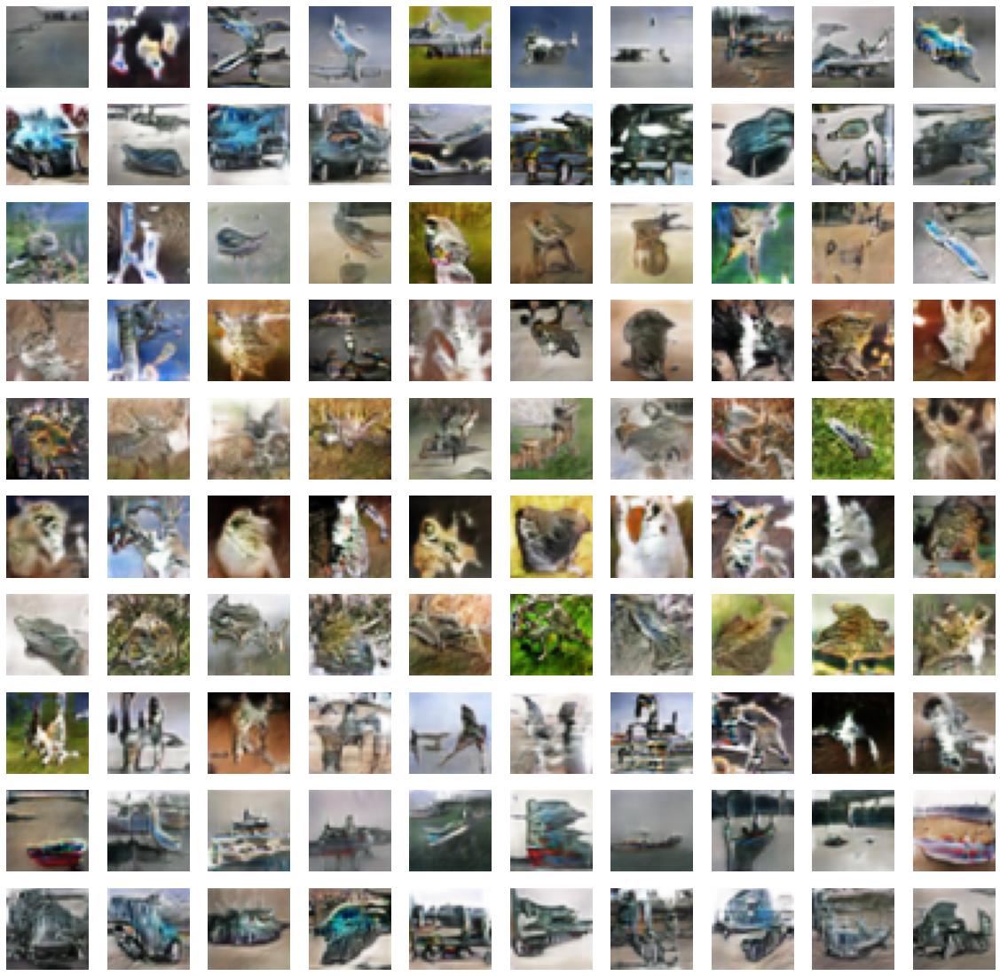

Step 37500 g_loss 3.1409 d_loss 0.1941
4/4 [==============================] - 0s 13ms/step


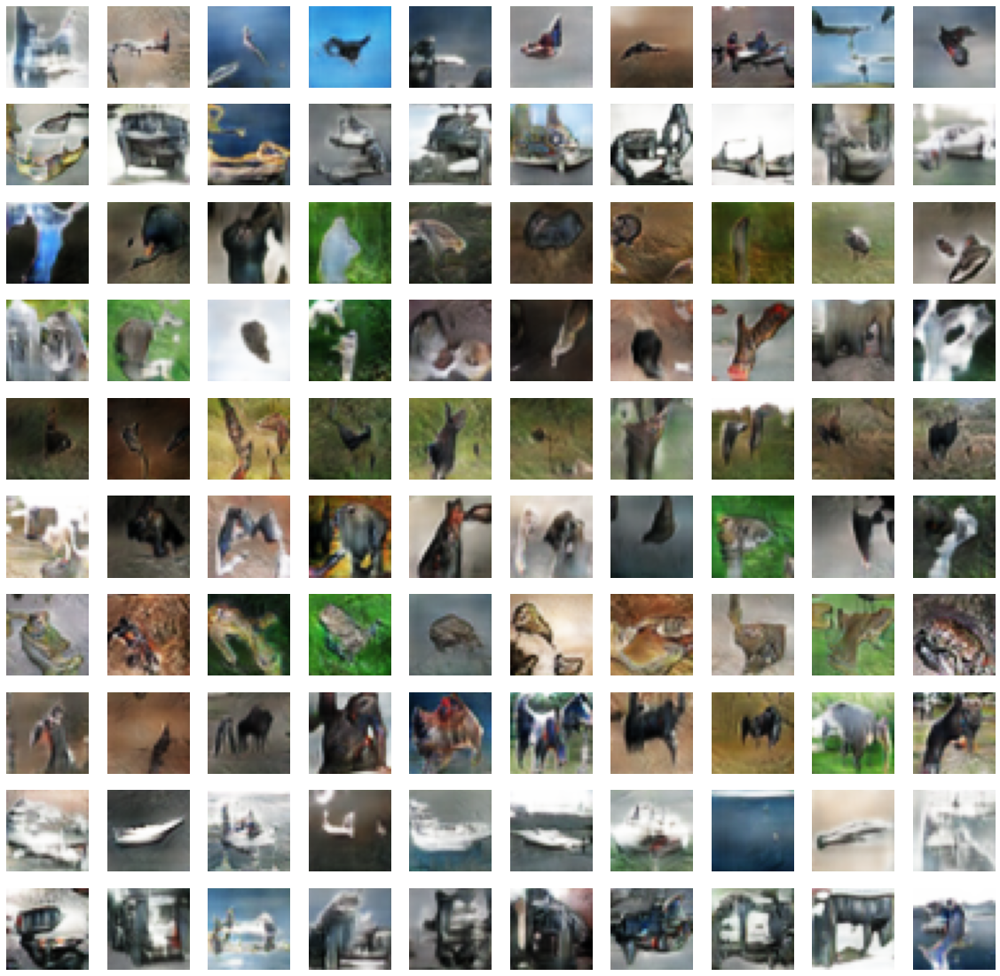

Step 40000 g_loss 4.4529 d_loss 0.2807
4/4 [==============================] - 0s 9ms/step


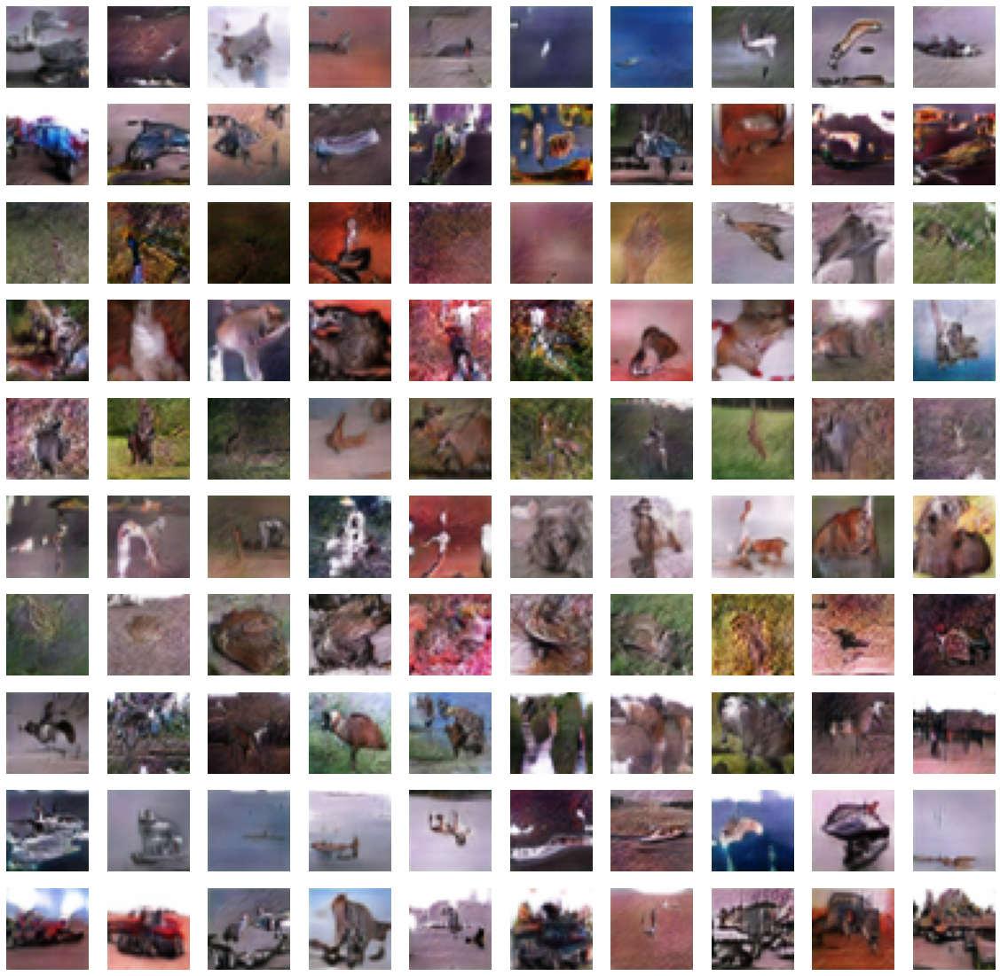

In [ ]:
def hinge_loss_d(y_true, y_pred):
    return tf.keras.losses.Hinge()(y_pred, y_true)

def hinge_loss_g(y_true, y_pred):
    return -tf.reduce_mean(y_pred)


class SAGAN():
    def __init__(self, image_shape, n_class, z_dim=128):
        self.z_dim = z_dim
        self.n_class = n_class

        # Build models
        self.optimizer_d = Adam(4e-4, 0.0, 0.9)
        self.optimizer_g = Adam(1e-4, 0.0, 0.9)
        self.discriminator = build_discriminator(n_class)

        self.generator = build_generator(z_dim, n_class)

        pred = self.discriminator([self.generator.output, self.generator.input[1]])
        self.model = Model(self.generator.input, pred, name='model')
        self.model.compile(optimizer=self.optimizer_g, loss=hinge_loss_g)


        self.hinge_loss = tf.keras.losses.Hinge()

    def hinge_loss_d(self, y, is_real):
        label = 1. if is_real else -1.
        loss = self.hinge_loss(y, label)
        return loss

    def hinge_loss_g(self, y):
        return -tf.reduce_mean(y)

    def train_step(self, train_gen):
        real_images, real_class_labels = next(train_gen)
        batch_size = real_class_labels.shape[0]
        real_labels = 1
        fake_labels = 0

        z = tf.random.normal((batch_size, self.z_dim))
        #fake_class_labels = tf.random.uniform([batch_size], 0, self.n_class, tf.int32)
        fake_class_labels = real_class_labels

        with tf.GradientTape() as d_tape, \
             tf.GradientTape() as g_tape:

            # forward pass
            fake_images = self.generator([z, fake_class_labels])
            pred_real = self.discriminator([real_images, real_class_labels])
            pred_fake = self.discriminator([fake_images, fake_class_labels])

            # discriminator losses
            loss_fake = self.hinge_loss_d(pred_fake, False)
            loss_real = self.hinge_loss_d(pred_real, True)

            # total loss
            d_loss = 0.5*(loss_fake + loss_real)
            d_gradients = d_tape.gradient(d_loss, self.discriminator.trainable_variables)
            self.optimizer_d.apply_gradients(zip(d_gradients, self.discriminator.trainable_variables))

            # Generator Loss
            g_loss = self.hinge_loss_g(pred_fake)
            g_gradients = g_tape.gradient(g_loss, self.generator.trainable_variables)
            self.optimizer_g.apply_gradients(zip(g_gradients, self.generator.trainable_variables))


        return g_loss, d_loss

    def show_val(self):
        images_per_class = 10
        z = tf.random.normal((images_per_class*self.n_class, self.z_dim))
        labels = []
        for i in range(self.n_class):
            labels += [i]*images_per_class
        labels = np.array(labels, dtype=np.int32)

        images = self.generator.predict([z, labels])
        images = images * 0.5 + 0.5
        grid_row = self.n_class
        grid_col = images_per_class

        scale = 2
        f, axarr = plt.subplots(grid_row, grid_col,
                                figsize=(grid_col*scale, grid_row*scale))

        for row in range(grid_row):
            ax = axarr if grid_row==1 else axarr[row]
            for col in range(grid_col):
                ax[col].imshow(images[row*grid_col + col])
                ax[col].axis('off')
        plt.show()


    def train(self, train_gen, steps, interval=100):
        for i in range(steps):
            g_loss, d_loss = self.train_step(train_gen)
            if i% interval == 0:
                msg = f'Step {i} g_loss {g_loss:.4f} d_loss {d_loss:.4f}'
                print(msg)
                self.show_val()


tf.keras.backend.clear_session()
sagan = SAGAN(IMAGE_SHAPE, 10)
sagan.train(iter(train_dataset), 50000, 2500)